In [1]:
import numpy as np
import anndata
import pandas as pd
import scanpy as sc
import scipy.sparse
import scanpy.external as sce

import warnings
warnings.filterwarnings('ignore')

from sklearn.neighbors import (KNeighborsClassifier,NeighborhoodComponentsAnalysis)
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE

import matplotlib.pyplot as plt
from matplotlib import rcParams
sc.set_figure_params(dpi=80) # increase to make the figures bigger
import plotly.tools as tls

import seaborn as sns
sns.set(style="whitegrid")

import collections
import scipy.sparse as sp_sparse
import h5py


In [2]:
sc.settings.verbosity = 3            
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.21.5 scipy==1.7.3 pandas==1.4.2 scikit-learn==1.0.2 statsmodels==0.13.2 python-igraph==0.10.2 pynndescent==0.5.8


In [3]:
##ASTROIDES

In [4]:
#Loading matrices - /filtered directory from outs of STARsolo mapping
astr7000Path = "/Users/Julia/Documents/lbdv/scRNAseq_analysis/scRNAseq_astr/mapping_genome/outs_STAR_solo_mito_oct23/count_Astr7000_genomemito_oct23/filtered/"
astrFacs1Path = "/Users/Julia/Documents/lbdv/scRNAseq_analysis/scRNAseq_astr/mapping_genome/outs_STAR_solo_mito_oct23/count_Astroides_Facs1_genomemito_oct23/filtered/"
astrFacs2Path = "/Users/Julia/Documents/lbdv/scRNAseq_analysis/scRNAseq_astr/mapping_genome/outs_STAR_solo_mito_oct23/count_Astroides_Facs2_genomemito_oct23/filtered/"
astr7000Data = sc.read_10x_mtx(astr7000Path) ; astr7000Data.var_names_make_unique()
astrFacs1Data = sc.read_10x_mtx(astrFacs1Path) ; astrFacs1Data.var_names_make_unique()
astrFacs2Data = sc.read_10x_mtx(astrFacs2Path) ; astrFacs1Data.var_names_make_unique()

--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.


In [5]:
#Metadata
astr7000Data.obs['type']="astr"
astr7000Data.obs['sample']="7000"

astrFacs1Data.obs['type']="astr"
astrFacs1Data.obs['sample']="facs1"

astrFacs2Data.obs['type']="astr"
astrFacs2Data.obs['sample']="facs2"

In [6]:
#Merging
astr = astr7000Data.concatenate(astrFacs1Data,astrFacs2Data,join='outer') 
print(astr.obs['sample'].value_counts())

facs2    9967
facs1    6979
7000     4587
Name: sample, dtype: int64


In [7]:
#Label mitochondrial genes tagged in gtf file used in the mapping
astr.var['mt'] = astr.var_names.str.startswith('XLOC_MITO')
astr.var

,gene_ids,feature_types,mt
STRG.1000,STRG.1000,Gene Expression,False
STRG.10001,STRG.10001,Gene Expression,False
STRG.10002,STRG.10002,Gene Expression,False
STRG.10003,STRG.10003,Gene Expression,False
STRG.10004,STRG.10004,Gene Expression,False
...,...,...,...
STRG.9996,STRG.9996,Gene Expression,False
STRG.9997,STRG.9997,Gene Expression,False
STRG.9998,STRG.9998,Gene Expression,False
STRG.9999,STRG.9999,Gene Expression,False


In [8]:
#Mitochondrial quality check
sc.pp.calculate_qc_metrics(astr, qc_vars=['mt'], percent_top=None, log1p=True, inplace=True)
mito_genes = astr.var_names.str.startswith('XLOC_MITO')
# For each cell compute fraction of counts in mito genes vs. all genes
astr.obs['percent_mt2'] = np.sum(astr[:, mito_genes].X, axis=1).A1 / np.sum(astr.X, axis=1).A1
# Add the total counts per cell as observations-annotation 
astr.obs['n_counts'] = astr.X.sum(axis=1).A1
astr

AnnData object with n_obs × n_vars = 21533 × 28331
    obs: 'type', 'sample', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'percent_mt2', 'n_counts'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

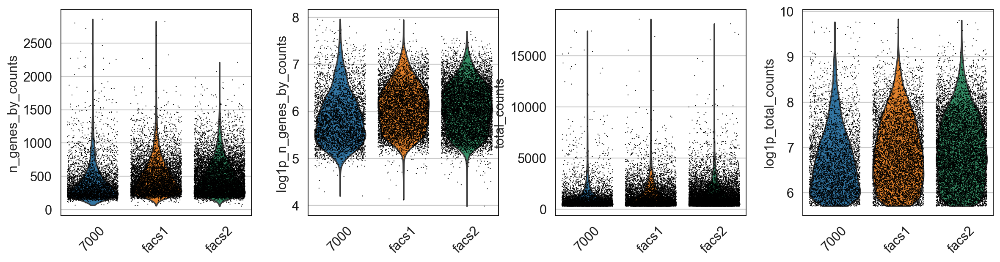

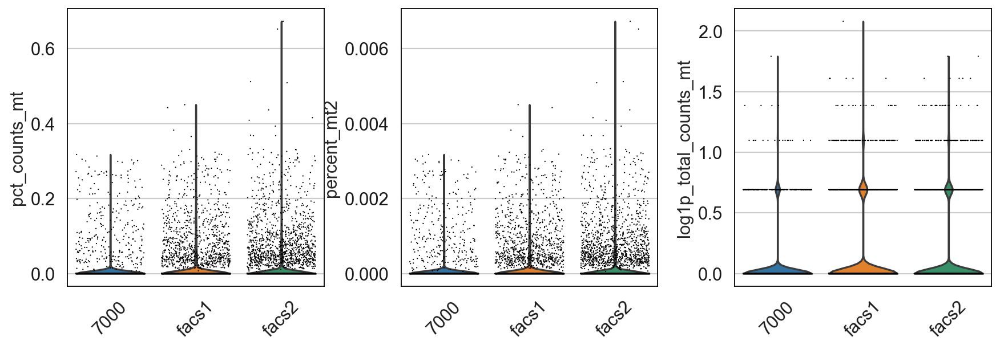

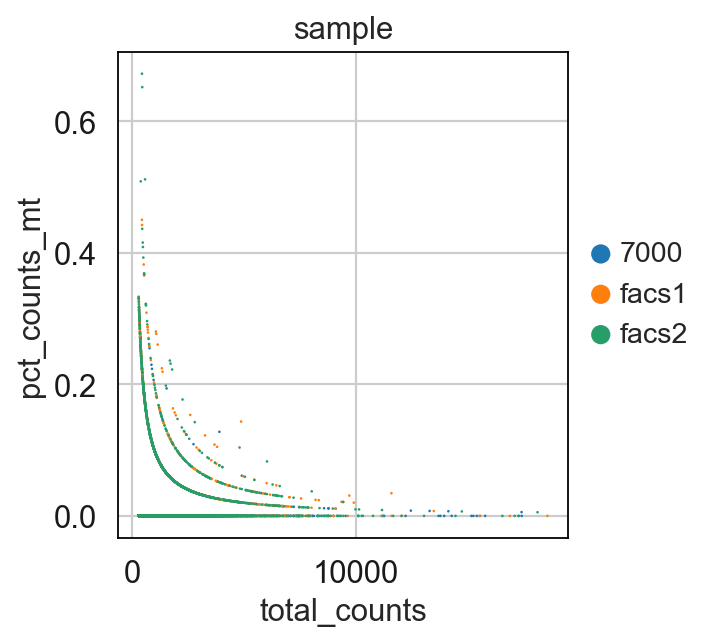

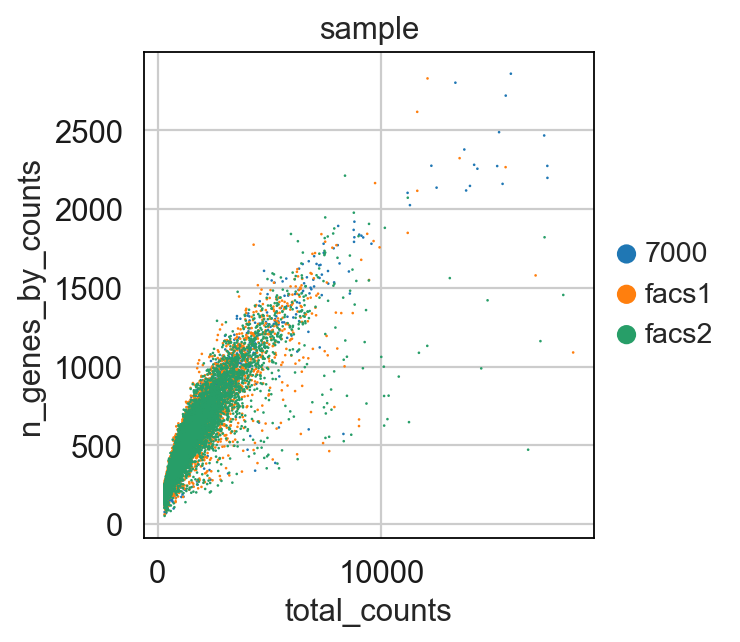

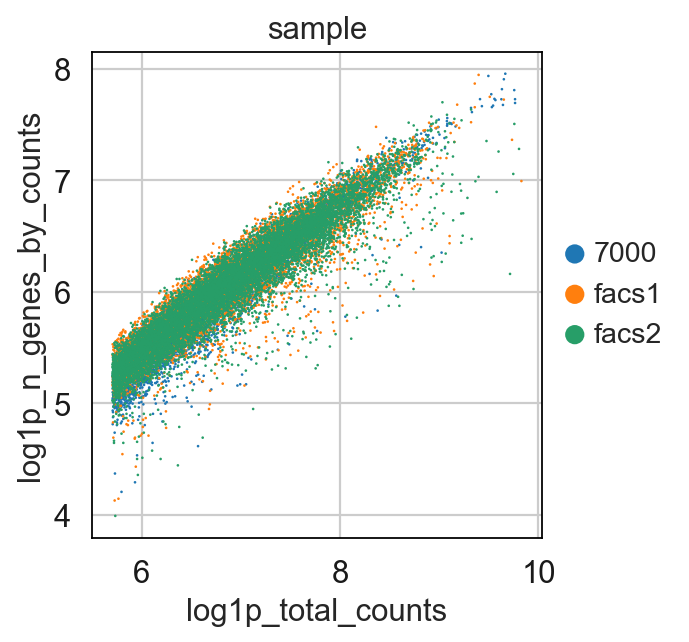

In [9]:
#Visulaize quality check measures
sc.pl.violin(astr, ['n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts'],
             jitter=0.4, groupby = 'sample', rotation= 45, ncols=2)
sc.pl.violin(astr, ['pct_counts_mt', 'percent_mt2','log1p_total_counts_mt'],
             jitter=0.4, groupby = 'sample', rotation= 45, ncols=2)

sc.pl.scatter(astr, x='total_counts', y='pct_counts_mt', color="sample")
sc.pl.scatter(astr, x='total_counts', y='n_genes_by_counts', color="sample")
sc.pl.scatter(astr, x='log1p_total_counts', y='log1p_n_genes_by_counts', color="sample")

In [10]:
#Filter out outliers and mitochondrial counts > 0.4%
astr = astr[astr.obs.n_genes_by_counts < 3000, :]
astr = astr[astr.obs.total_counts< 10000, :]
astr = astr[astr.obs.pct_counts_mt < 0.4, :]
astr

View of AnnData object with n_obs × n_vars = 21480 × 28331
    obs: 'type', 'sample', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'percent_mt2', 'n_counts'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'sample_colors'

In [11]:
#Filtering by min number of genes and cells
sc.pp.filter_cells(astr, min_genes=200)
sc.pp.filter_genes(astr, min_cells=3)

print(astr.n_obs, astr.n_vars)

filtered out 1520 cells that have less than 200 genes expressed
filtered out 6379 genes that are detected in less than 3 cells
19960 21952


In [12]:
#Normalize and log transform
sc.pp.normalize_total(astr, target_sum=1e4)
sc.pp.log1p(astr)

#Compute  high variable genes
sc.pp.highly_variable_genes(astr, min_mean=0.0125, max_mean=3, min_disp=0.5)
astr.raw = astr

#Subset to highly variable genes to reduce noise
astr = astr[:, astr.var.highly_variable]
#Data regression
sc.pp.regress_out(astr, ['total_counts', 'pct_counts_mt'])
#Data scaling
sc.pp.scale(astr, max_value=10)
#Compute PCs
sc.tl.pca(astr, svd_solver='arpack')

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use
    finished (0:00:26)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)


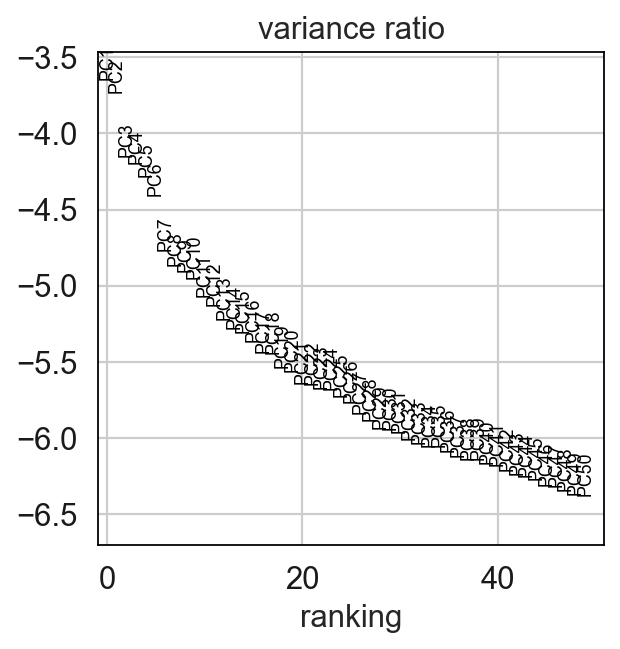

In [13]:
#Elbow plot of PCs
sc.pl.pca_variance_ratio(astr, log=True, n_pcs = 50)


In [14]:
#Custering - 1) Compute neighbors graph 
sc.pp.neighbors(astr, n_neighbors=50, n_pcs=26, knn=True)

#Custering - 2)Apply the Leiden graph-clustering algorithm
sc.tl.leiden(astr,resolution=0.9)

#Computing umap
sc.tl.umap(astr)

computing neighbors
    using 'X_pca' with n_pcs = 26
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:02:46)
running Leiden clustering
    finished: found 30 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:13)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:33)


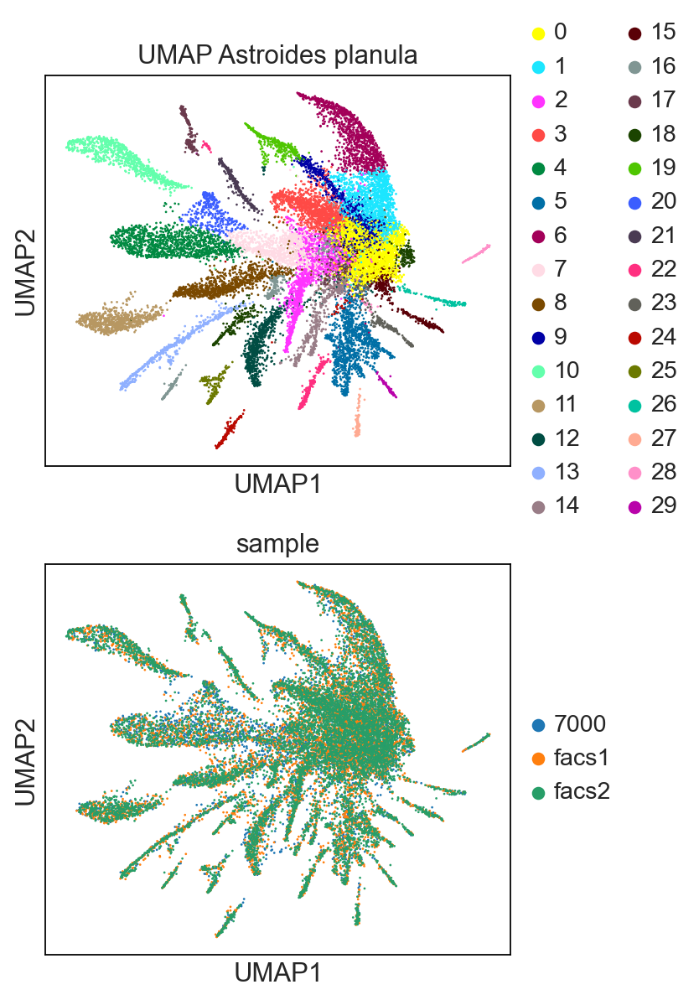

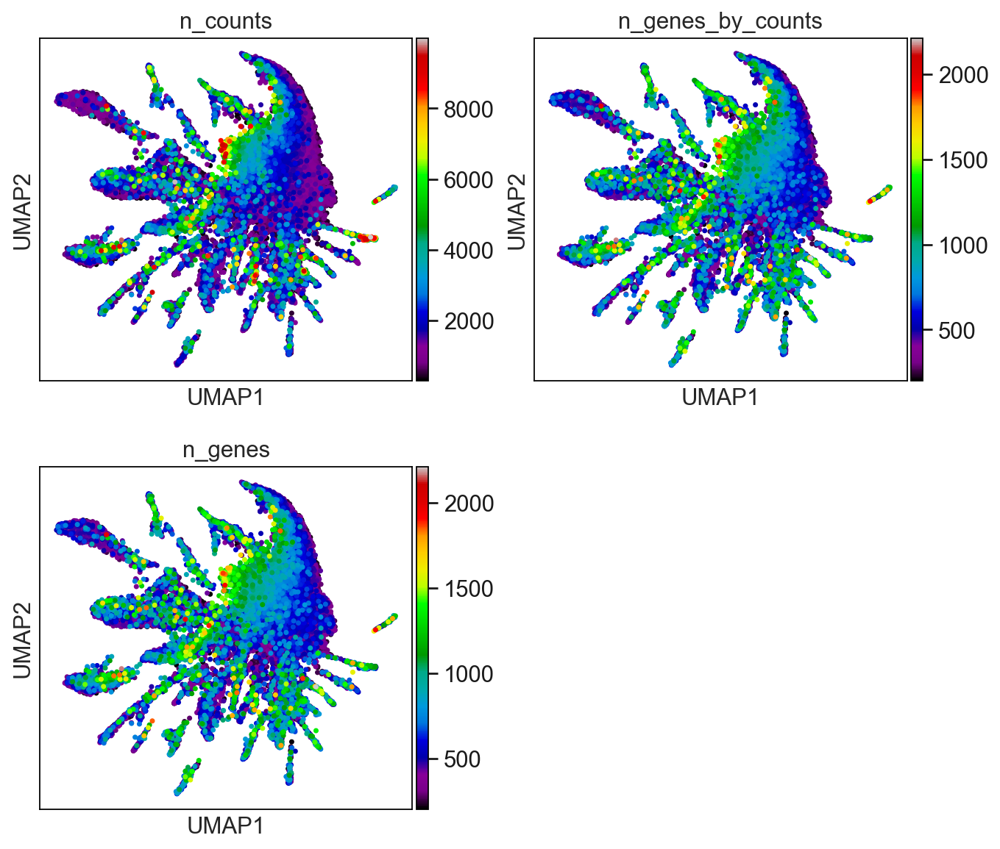

In [15]:
#Visualize umap
sc.pl.umap(astr, color=['leiden','sample'], title="UMAP Astroides planula",ncols=1)
sc.pl.umap(astr, color=['n_counts', 'n_genes_by_counts', 'n_genes'],color_map='nipy_spectral', ncols=2, size=40)


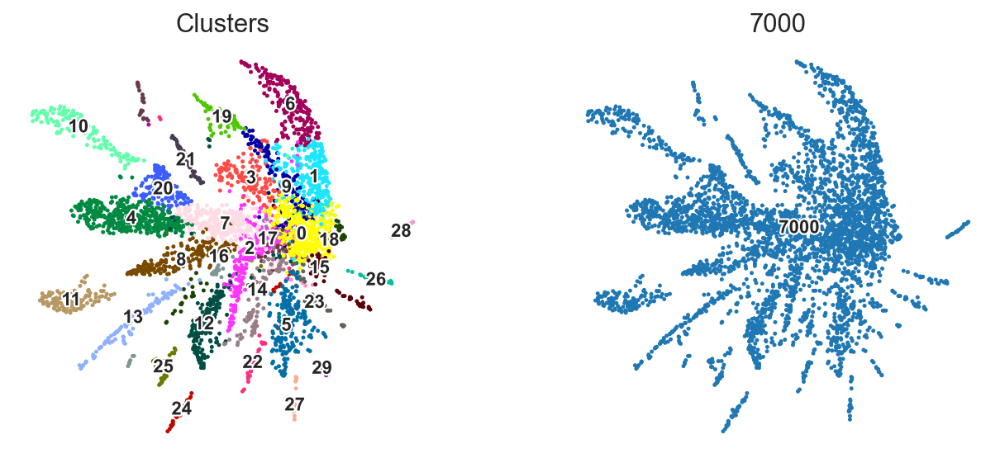

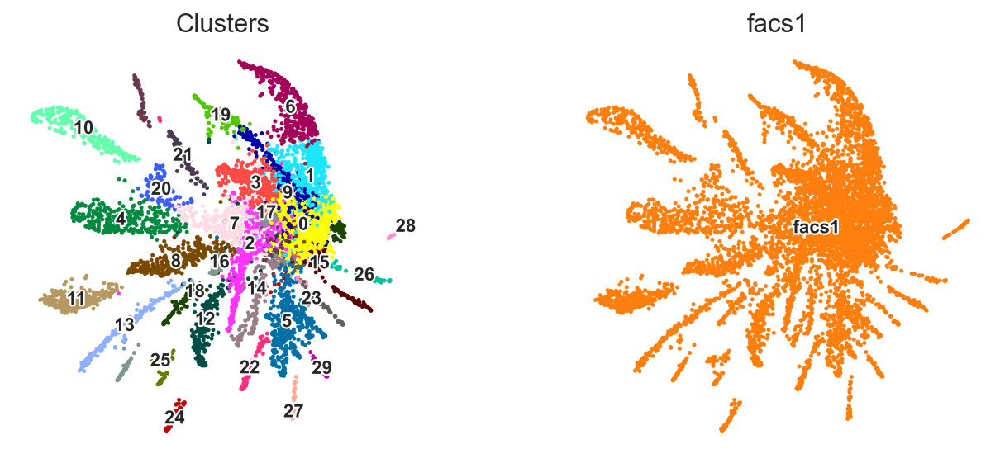

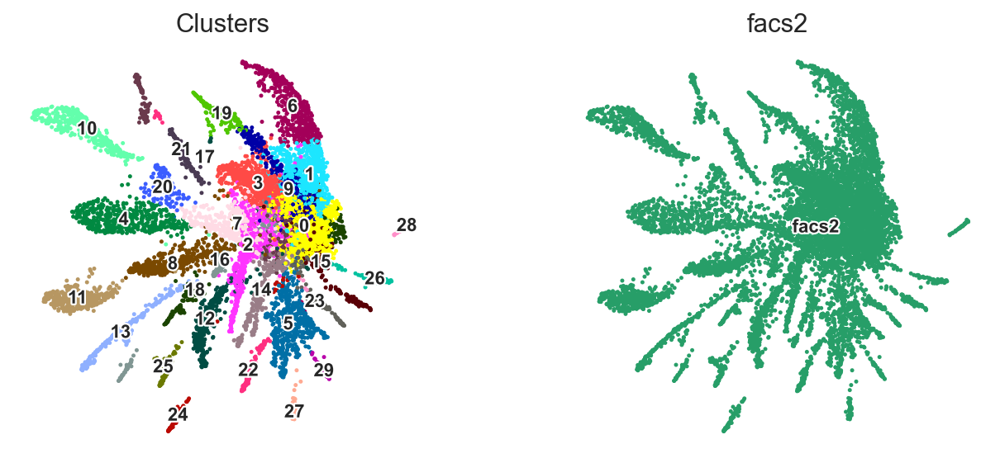

In [17]:
#Plot samples individually
sc.pl.umap(astr[astr.obs.loc[astr.obs['sample'].isin(['7000'])].index.tolist(), ], color= ['leiden','sample'], title=['Clusters', '7000'], legend_loc= 'on data',  legend_fontsize=10, legend_fontoutline=2,  frameon=False, size=20,ncols=2)
sc.pl.umap(astr[astr.obs.loc[astr.obs['sample'].isin(['facs1'])].index.tolist(), ], color= ['leiden','sample'], title=['Clusters', 'facs1'], legend_loc= 'on data',  legend_fontsize=10, legend_fontoutline=2,  frameon=False, size=20,ncols=2)
sc.pl.umap(astr[astr.obs.loc[astr.obs['sample'].isin(['facs2'])].index.tolist(), ], color= ['leiden','sample'], title=['Clusters', 'facs2'], legend_loc= 'on data',  legend_fontsize=10, legend_fontoutline=2,  frameon=False, size=20,ncols=2)


In [18]:
#Rank and extract marker genes for all clusters
sc.tl.rank_genes_groups(astr, 'leiden', n_genes=1000,method='wilcoxon')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:43)


    using 'X_pca' with n_pcs = 26
Storing dendrogram info using `.uns['dendrogram_leiden']`


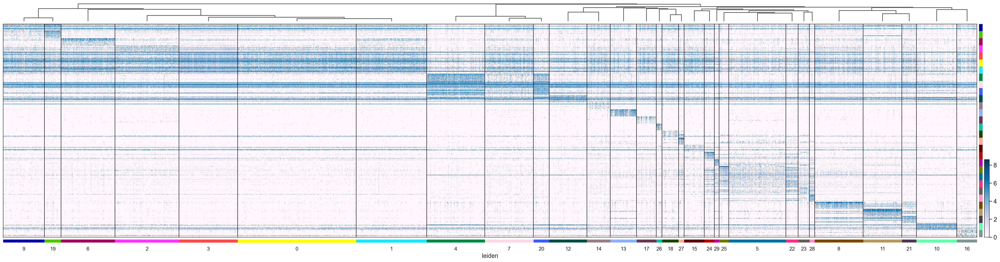

In [19]:
#Heatmap of top 10 marker genes per cluster
sc.tl.dendrogram(astr, 'leiden', n_pcs=26)
sc.pl.rank_genes_groups_heatmap(astr, n_genes=10, swap_axes=True, cmap='PuBu', show=True, figsize=(40,10))

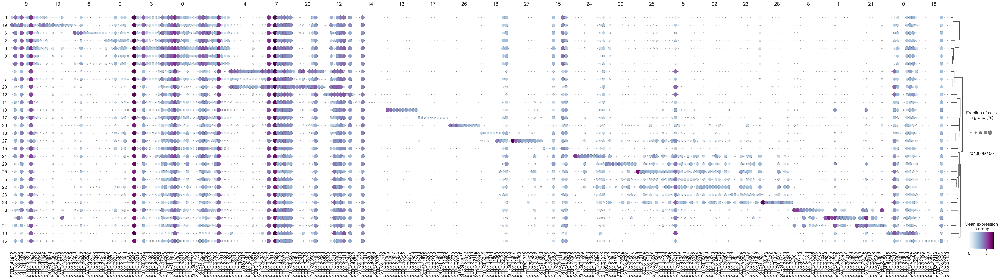

In [20]:
#Dotplot of top 10 marker genes per cluster
sc.settings.set_figure_params(facecolor='white',fontsize=18)
sc.pl.rank_genes_groups_dotplot(astr, n_genes=10, groupby='leiden', cmap='BuPu', show=True, figsize=(60,15))

In [21]:
#Remove cluster 7
astr = astr.raw.to_adata()
astr.obs['leiden'].cat.categories
astr_new = astr[~astr.obs['leiden'].isin(['7']),:].copy()
astr_new

AnnData object with n_obs × n_vars = 18964 × 21952
    obs: 'type', 'sample', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'percent_mt2', 'n_counts', 'n_genes', 'leiden'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'sample_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'umap', 'leiden_colors', 'rank_genes_groups', 'dendrogram_leiden'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

In [22]:
#Re-compute clustering
sc.pp.neighbors(astr_new, n_neighbors=50, n_pcs=26, knn=True)
sc.tl.leiden(astr_new,key_added='leiden_new',resolution=1) 
sc.tl.umap(astr_new)
astr_new.obs['newClusters'] = pd.Categorical(astr_new.obs['leiden_new'] )

computing neighbors
    using 'X_pca' with n_pcs = 26
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:08)
running Leiden clustering
    finished: found 31 clusters and added
    'leiden_new', the cluster labels (adata.obs, categorical) (0:00:07)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:27)


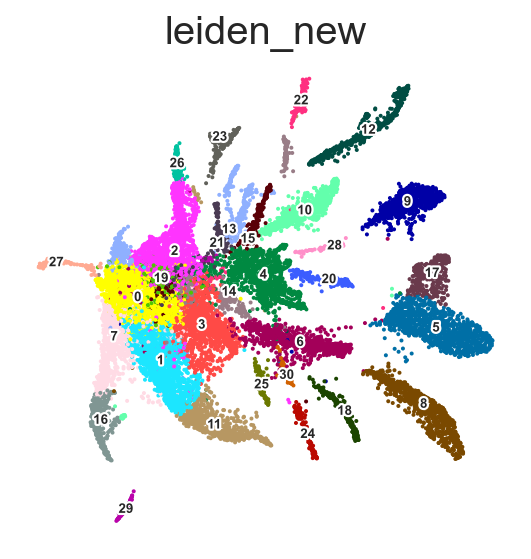

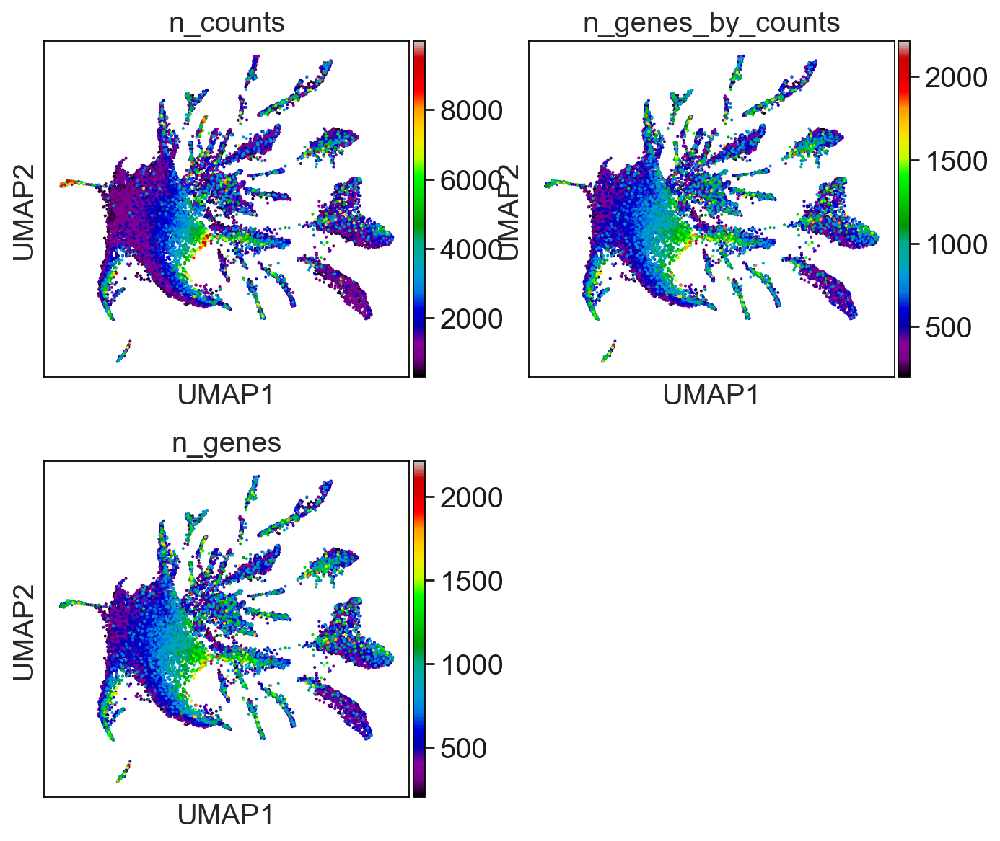

In [23]:
#Final UMAP
#sc.set_figure_params(dpi=80)
sc.pl.umap(astr_new, color=['leiden_new'], legend_loc= 'on data', legend_fontsize=6, legend_fontoutline=2, size= 13, frameon=False)
sc.pl.umap(astr_new, color=['n_counts', 'n_genes_by_counts', 'n_genes'],color_map='nipy_spectral', ncols=2, size=13)

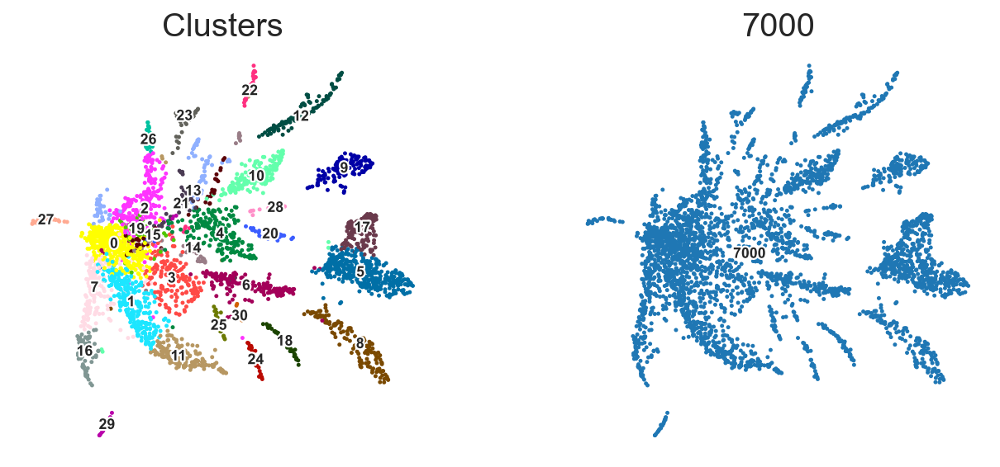

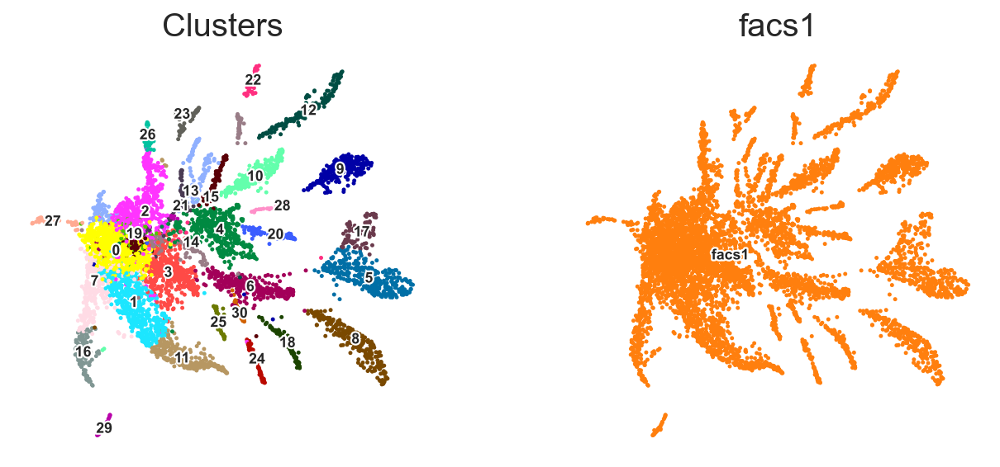

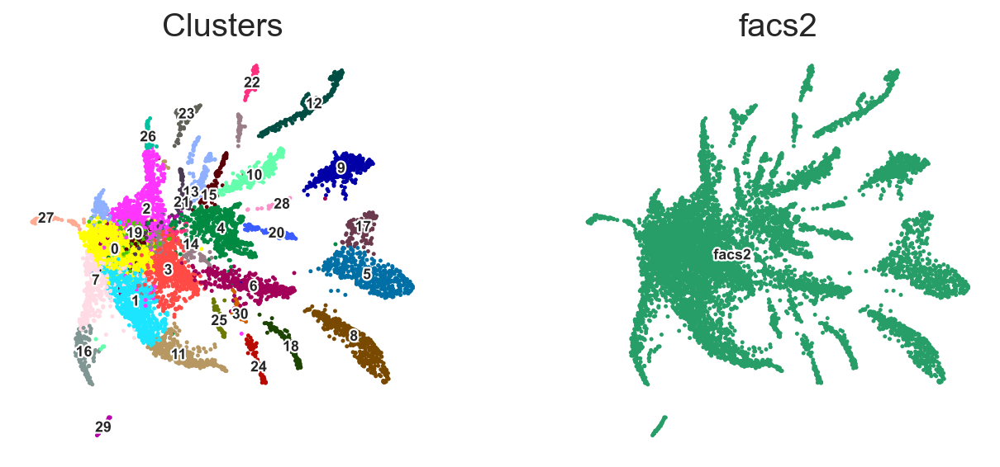

In [24]:
#Plot samples individually
sc.pl.umap(astr_new[astr_new.obs.loc[astr_new.obs['sample'].isin(['7000'])].index.tolist(), ], color= ['leiden_new','sample'], title=['Clusters', '7000'], legend_loc= 'on data',  legend_fontsize=8, legend_fontoutline=2,  frameon=False, size=20,ncols=2)
sc.pl.umap(astr_new[astr_new.obs.loc[astr_new.obs['sample'].isin(['facs1'])].index.tolist(), ], color= ['leiden_new','sample'], title=['Clusters', 'facs1'], legend_loc= 'on data',  legend_fontsize=8, legend_fontoutline=2,  frameon=False, size=20,ncols=2)
sc.pl.umap(astr_new[astr_new.obs.loc[astr_new.obs['sample'].isin(['facs2'])].index.tolist(), ], color= ['leiden_new','sample'], title=['Clusters', 'facs2'], legend_loc= 'on data',  legend_fontsize=8, legend_fontoutline=2,  frameon=False, size=20,ncols=2)

In [25]:
#Rank and extract marker genes for all clusters
sc.tl.rank_genes_groups(astr_new, 'leiden_new', n_genes=1000,method='wilcoxon')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:42)


    using 'X_pca' with n_pcs = 26
Storing dendrogram info using `.uns['dendrogram_leiden_new']`


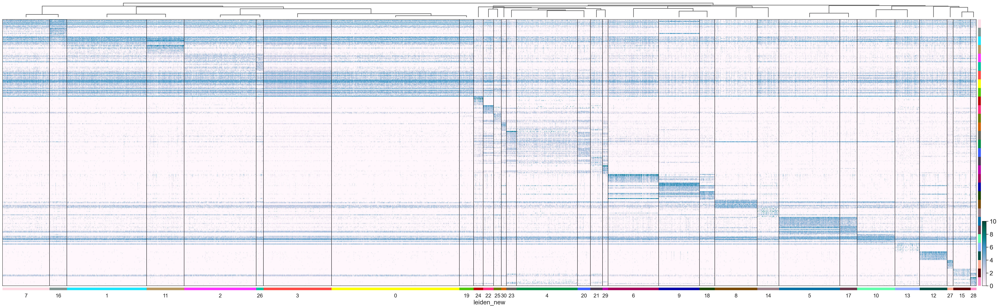

In [26]:
#Heatmap of top 10 marker genes per cluster
#sc.settings.set_figure_params(dpi=80, facecolor='white',fontsize=25)
sc.tl.dendrogram(astr_new, 'leiden_new', n_pcs=26)
sc.pl.rank_genes_groups_heatmap(astr_new, n_genes=10, swap_axes=True, vmin=0, vmax=10, cmap='PuBuGn', show=True, figsize=(50,15))

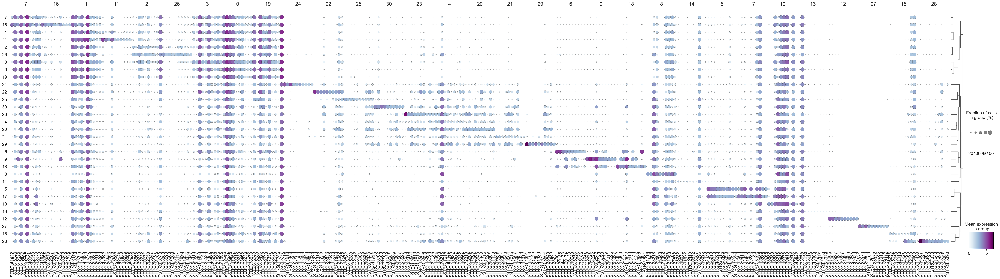

In [27]:
#Dotplot of top 10 marker genes per cluster
sc.pl.rank_genes_groups_dotplot(astr_new, n_genes=10, groupby='leiden_new', cmap='BuPu', show=True, figsize=(60,15))

In [28]:
#Make a dataframe with cluster marker genes
clusters = np.unique(astr_new.obs['leiden_new'])
clusters = clusters.astype('int') 
clusters = np.sort(clusters) 
clusters = clusters.astype('str') 
markers_astr = pd.DataFrame()
clus = []
markerGene = []
padj = []
logfoldchange = []
for i in clusters:
  genes = astr_new.uns['rank_genes_groups']['names'][str(i)]
  clus += list(np.repeat(i,len(genes)))
  markerGene += list(genes)
  padj += list(astr_new.uns['rank_genes_groups']['pvals_adj'][str(i)])
  logfoldchange += list(astr_new.uns ['rank_genes_groups']['logfoldchanges'][str(i)])
markers_astr['clus'] = clus
markers_astr['markerGene'] = markerGene
markers_astr['padj'] = padj
markers_astr['logfoldchange'] = logfoldchange

In [29]:
#Select only significant markers
significant = []
print(markers_astr)
for index,row in markers_astr.iterrows():
    if row['padj'] < 0.05:
        significant += "T"
    else:
        significant += "F"
markers_astr['significant'] = significant
significant_markers_astr = markers_astr[markers_astr.significant == "T"]

      clus  markerGene           padj  logfoldchange
0        0   STRG.8743   0.000000e+00       2.183627
1        0  STRG.15777  1.284494e-236       0.930133
2        0   STRG.6496  1.125847e-224       1.496866
3        0  STRG.17357  1.120776e-189       1.346818
4        0  STRG.30316  6.791221e-168       1.878497
...    ...         ...            ...            ...
30995   30  STRG.25393   1.000000e+00       2.544098
30996   30  STRG.19768   1.000000e+00       0.303637
30997   30  STRG.44108   1.000000e+00       2.403997
30998   30  STRG.19721   1.000000e+00       0.981469
30999   30   STRG.4405   1.000000e+00       1.436360

[31000 rows x 4 columns]


In [77]:
#significant_markers_astr.to_csv('/Users/Julia/Desktop/supplementary_paper_Sept24/sc_atlases/astroides/astroides_significant_markers_FC.csv', sep =',')

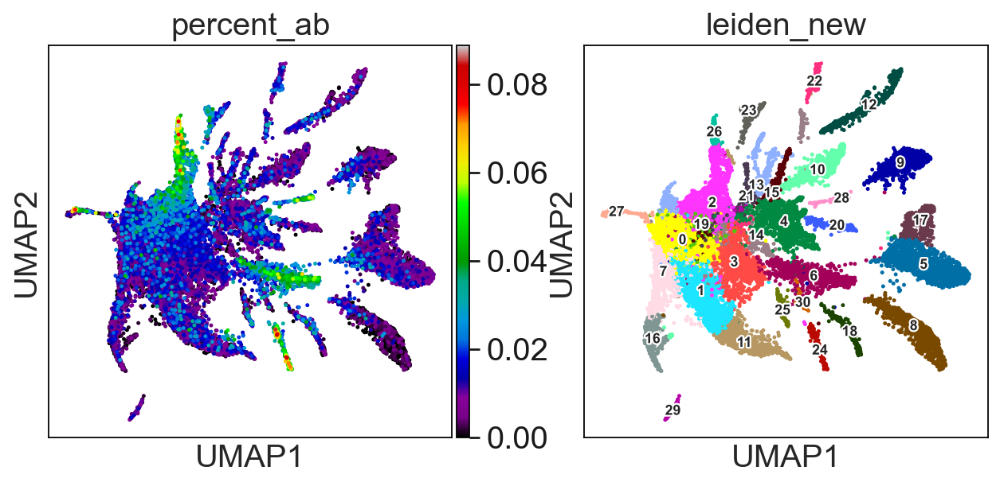

In [60]:
#Plot percentage of aboral genes per cluster in the umap
#upload gene IDs of aboral genes LFC>1, p-value<0.05
all_aboral = set()
with open('/Users/Julia/Documents/lbdv/python_scripts/aboral_clusters/IDs_astroides_aboral_lcf1') as fh:
    for line in fh:
        line = line.rstrip()
        parts = line.split()
        all_aboral.add(parts[0])
aboral_genes = astr_new.var_names.isin(all_aboral)
astr_new.obs['percent_ab'] = np.sum(
  astr_new[:,aboral_genes].X, axis=1).A1 / np.sum(astr_new.X, axis=1).A1
sc.pl.umap(astr_new,color=['percent_ab','leiden_new'],size=20,color_map='nipy_spectral', legend_loc= 'on data' , legend_fontoutline=2, legend_fontsize=8)

In [ ]:
#POCILLOPORA

In [61]:
#Loading matrices - /filtered directory from outs of STARsolo mapping
pdam_4_1_C3_Path = "/Users/Julia/Documents/lbdv/scRNAseq_analysis/scRNAseq_pocillopora_March23/STARsolo_ncbi_0ct23/outs_STAR/count_pdam_4-1_C3/filtered/"
pdam_A_1_C6_1_Path = "/Users/Julia/Documents/lbdv/scRNAseq_analysis/scRNAseq_pocillopora_March23/STARsolo_ncbi_0ct23/outs_STAR/count_pdam_A-1_C6_1/filtered/"
pdam_A_1_C6_2_Path = "/Users/Julia/Documents/lbdv/scRNAseq_analysis/scRNAseq_pocillopora_March23/STARsolo_ncbi_0ct23/outs_STAR/count_pdam_A-1_C6_2/filtered/"
pdam_4_1_C3_Data = sc.read_10x_mtx(pdam_4_1_C3_Path) ; pdam_4_1_C3_Data.var_names_make_unique()
pdam_A_1_C6_1_Data = sc.read_10x_mtx(pdam_A_1_C6_1_Path) ; pdam_A_1_C6_1_Data.var_names_make_unique()
pdam_A_1_C6_2_Data = sc.read_10x_mtx(pdam_A_1_C6_2_Path) ; pdam_A_1_C6_2_Data.var_names_make_unique()

In [66]:
#Metadata
pdam_4_1_C3_Data.obs['type']="pdam"
pdam_4_1_C3_Data.obs['sample']="4.1_C3"

pdam_A_1_C6_1_Data.obs['type']="pdam"
pdam_A_1_C6_1_Data.obs['sample']="A.1_C6_1"

pdam_A_1_C6_2_Data.obs['type']="pdam"
pdam_A_1_C6_2_Data.obs['sample']="A.1_C6_2"


In [67]:
#Merging
pdam = pdam_4_1_C3_Data.concatenate(pdam_A_1_C6_1_Data,pdam_A_1_C6_2_Data,join='outer') 
print(pdam.obs['sample'].value_counts())

4.1_C3      4902
A.1_C6_1    2609
A.1_C6_2    2506
Name: sample, dtype: int64


In [68]:
#Label mitochondrial genes tagged in the gtf file used for mapping
pdam.var['mt'] = pdam.var_names.str.startswith('XLOC_MITO')
pdam.var

,gene_ids,feature_types,mt
XP_027049641.1,XP_027049641.1,Gene Expression,False
XP_027040096.1,XP_027040096.1,Gene Expression,False
XP_027038702.1,XP_027038702.1,Gene Expression,False
XP_027042395.1,XP_027042395.1,Gene Expression,False
XP_027038121.1,XP_027038121.1,Gene Expression,False
...,...,...,...
XP_027059860.1,XP_027059860.1,Gene Expression,False
XP_027059872.1,XP_027059872.1,Gene Expression,False
XP_027059873.1,XP_027059873.1,Gene Expression,False
XP_027059881.1,XP_027059881.1,Gene Expression,False


In [69]:
#Mitochondrial quality check
sc.pp.calculate_qc_metrics(pdam, qc_vars=['mt'], percent_top=None, log1p=True, inplace=True)
mito_genes = pdam.var_names.str.startswith('XLOC_MITO')
# For each cell compute fraction of counts in mito genes vs. all genes
pdam.obs['percent_mt2'] = np.sum(pdam[:, mito_genes].X, axis=1).A1 / np.sum(pdam.X, axis=1).A1
# Add the total counts per cell as observations-annotation 
pdam.obs['n_counts'] = pdam.X.sum(axis=1).A1
pdam

AnnData object with n_obs × n_vars = 10017 × 19923
    obs: 'type', 'sample', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'percent_mt2', 'n_counts'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

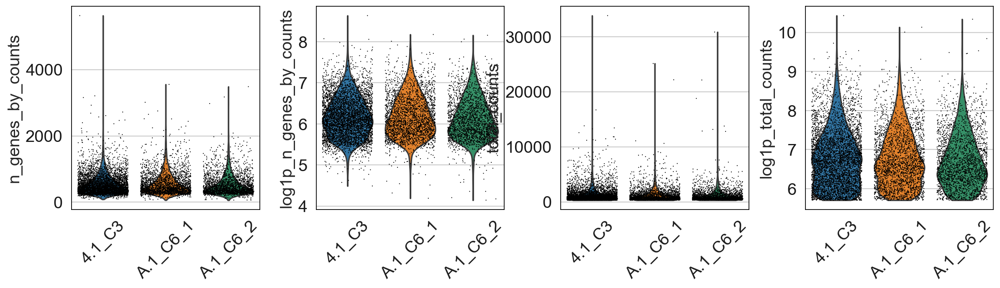

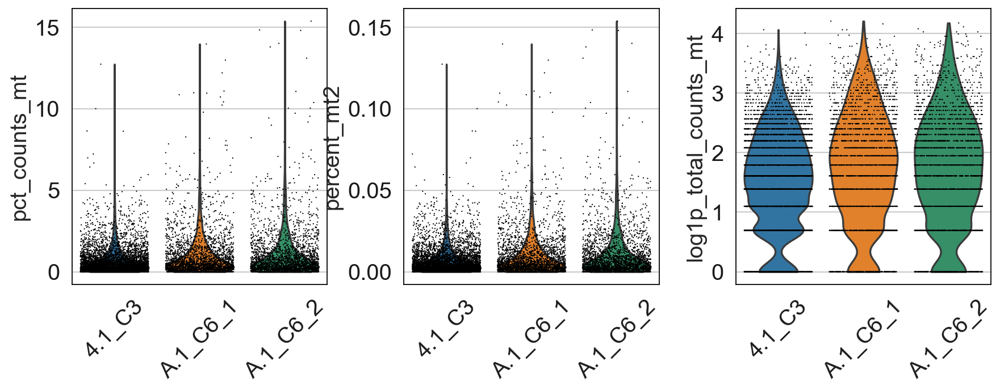

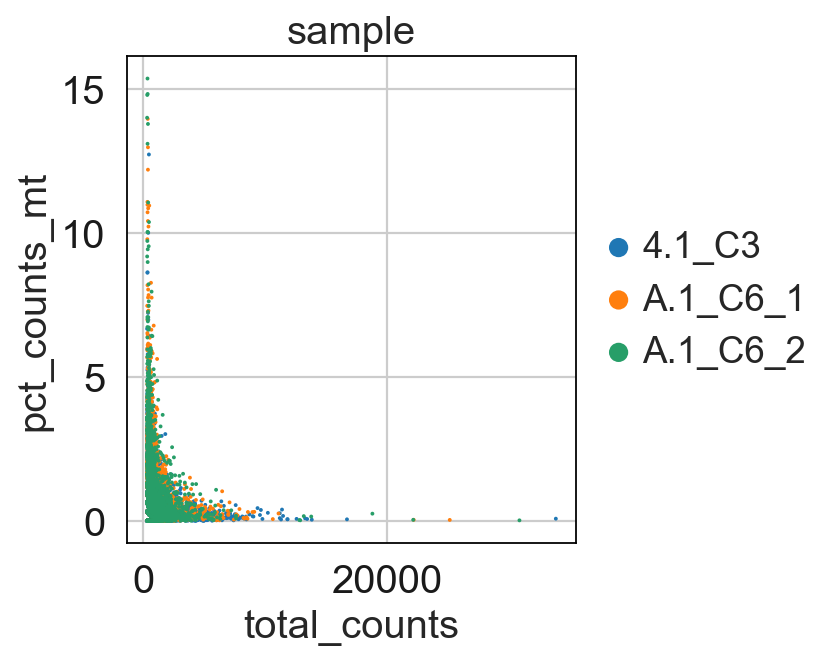

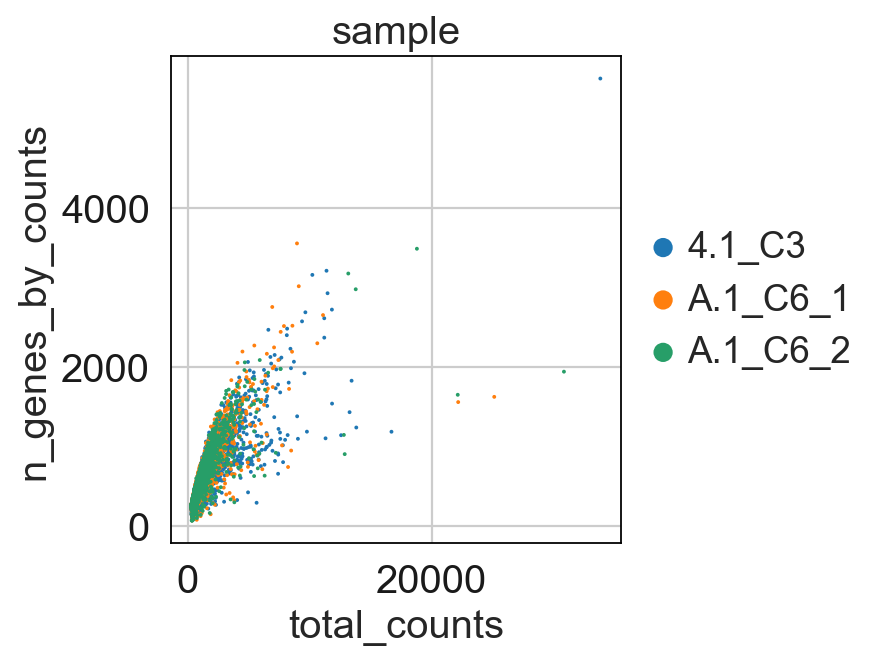

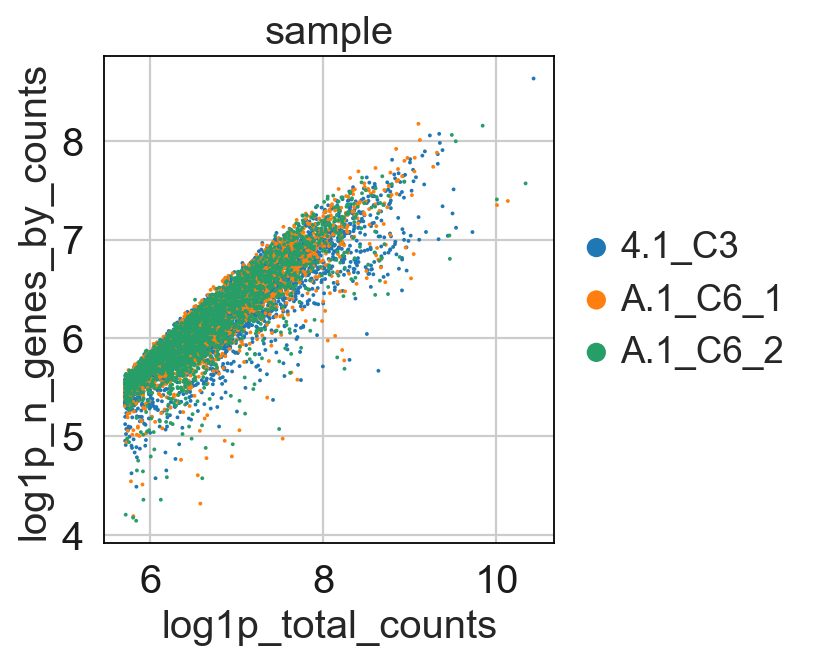

In [70]:
#Plot quality check measures
sc.pl.violin(pdam, ['n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts'],
             jitter=0.4, groupby = 'sample', rotation= 45, ncols=2)
sc.pl.violin(pdam, ['pct_counts_mt', 'percent_mt2','log1p_total_counts_mt'],
             jitter=0.4, groupby = 'sample', rotation= 45, ncols=2)


sc.pl.scatter(pdam, x='total_counts', y='pct_counts_mt', color="sample")
sc.pl.scatter(pdam, x='total_counts', y='n_genes_by_counts', color="sample")
sc.pl.scatter(pdam, x='log1p_total_counts', y='log1p_n_genes_by_counts', color="sample")

In [71]:
#Filter out outliers and mitochondrial counts > 5%
pdam = pdam[pdam.obs.n_genes_by_counts < 4000, :]
pdam = pdam[pdam.obs.total_counts< 20000, :]
pdam = pdam[pdam.obs.pct_counts_mt < 5, :]
pdam

View of AnnData object with n_obs × n_vars = 9887 × 19923
    obs: 'type', 'sample', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'percent_mt2', 'n_counts'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'sample_colors'

In [72]:
#Filtering by minimum number of genes and cells
sc.pp.filter_cells(pdam, min_genes=200)
sc.pp.filter_genes(pdam, min_cells=3)

print(pdam.n_obs, pdam.n_vars)

9733 17112


In [73]:
#Normalize and log transform
sc.pp.normalize_total(pdam, target_sum=1e4)
sc.pp.log1p(pdam)

#Compute  high variable genes
sc.pp.highly_variable_genes(pdam, min_mean=0.0125, max_mean=3, min_disp=0.5)
pdam.raw = pdam

#Subset to highly variable genes to reduce noise
pdam = pdam[:, pdam.var.highly_variable]
#Data regression
sc.pp.regress_out(pdam, ['total_counts', 'pct_counts_mt'])
#Data scaling
sc.pp.scale(pdam, max_value=10)
#Compute PCs
sc.tl.pca(pdam, svd_solver='arpack')

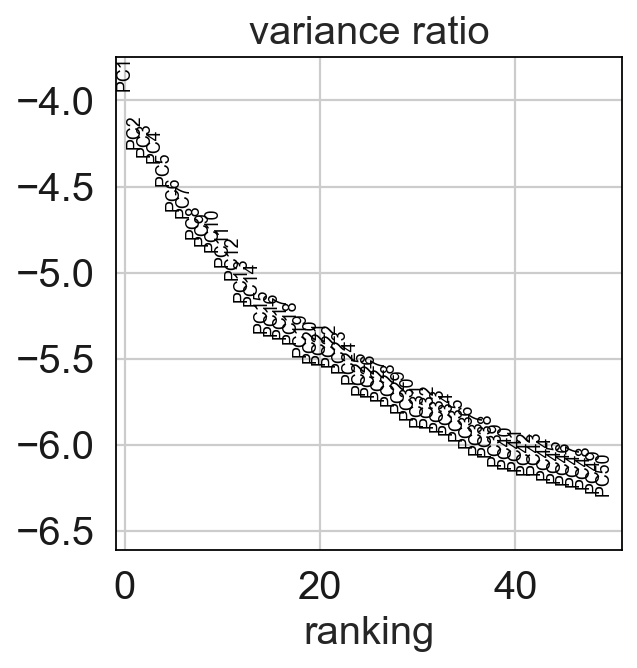

In [74]:
#Elbow plot of PCs
sc.pl.pca_variance_ratio(pdam, log=True, n_pcs = 50)

In [75]:
#Custering - 1) Compute neighbors graph 
sc.pp.neighbors(pdam, n_neighbors=50, n_pcs=23, knn=True)

#Custering - 2)Apply the Leiden graph-clustering algorithm
sc.tl.leiden(pdam,resolution=1)

#Computing umap
sc.tl.umap(pdam)

#Save raw data into the object
pdam = pdam.raw.to_adata()


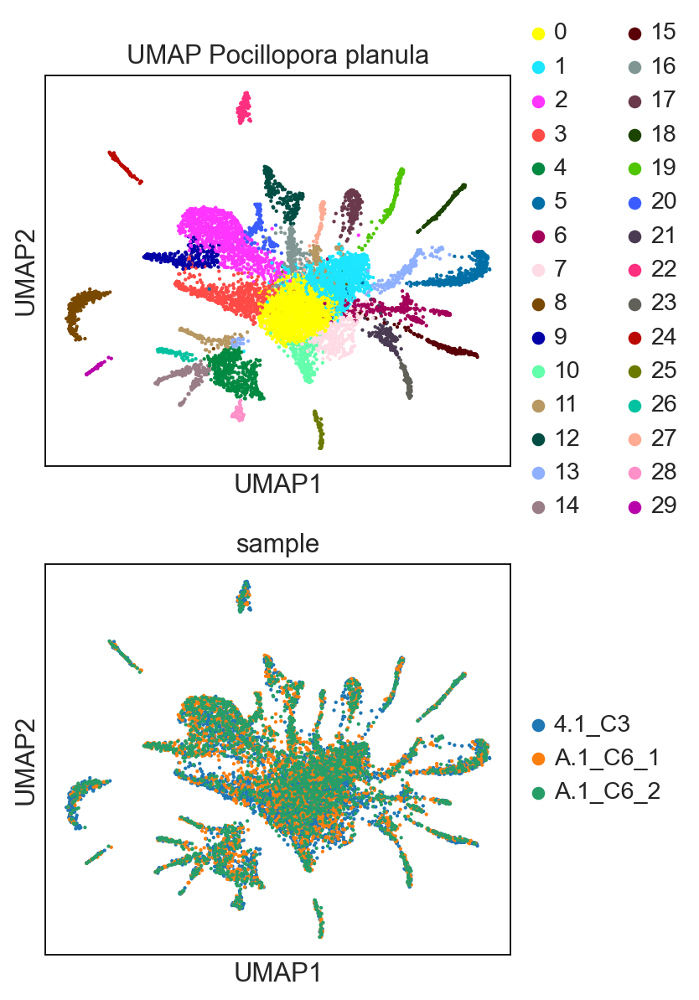

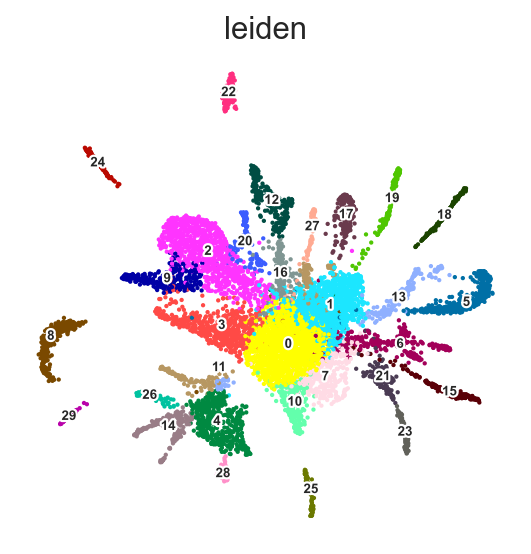

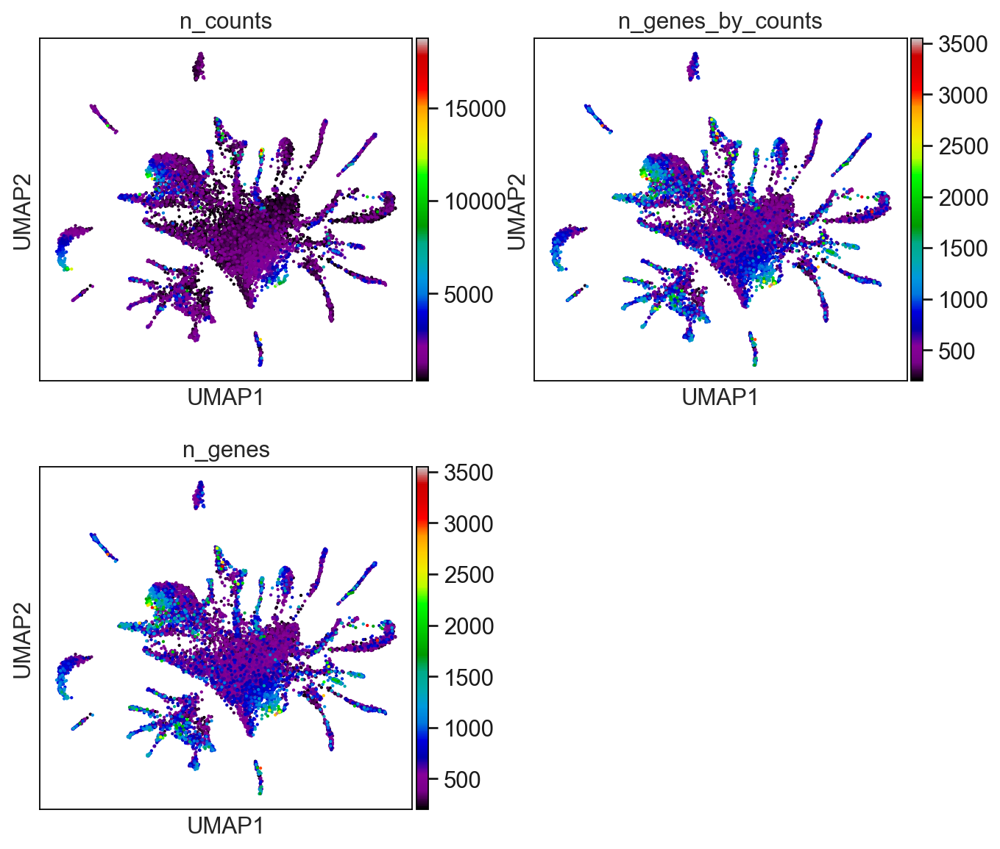

In [76]:
#Visualize umap
sc.set_figure_params(dpi=80)
sc.pl.umap(pdam, color=['leiden','sample'], title="UMAP Pocillopora planula",ncols=1, size=15)
sc.pl.umap(pdam, color=['leiden'], legend_loc= 'on data', legend_fontsize=6, legend_fontoutline=2, size= 15, frameon=False)
sc.pl.umap(pdam, color=['n_counts', 'n_genes_by_counts', 'n_genes'],color_map='nipy_spectral', ncols=2, size=15)


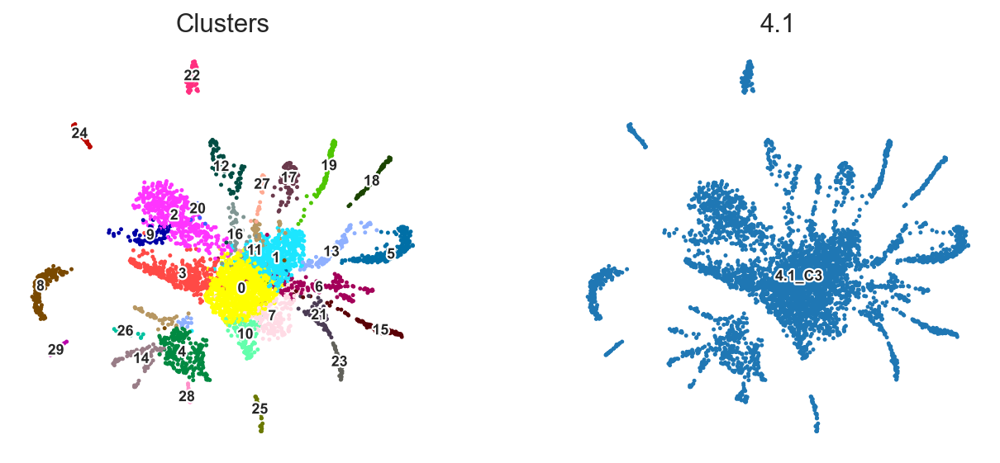

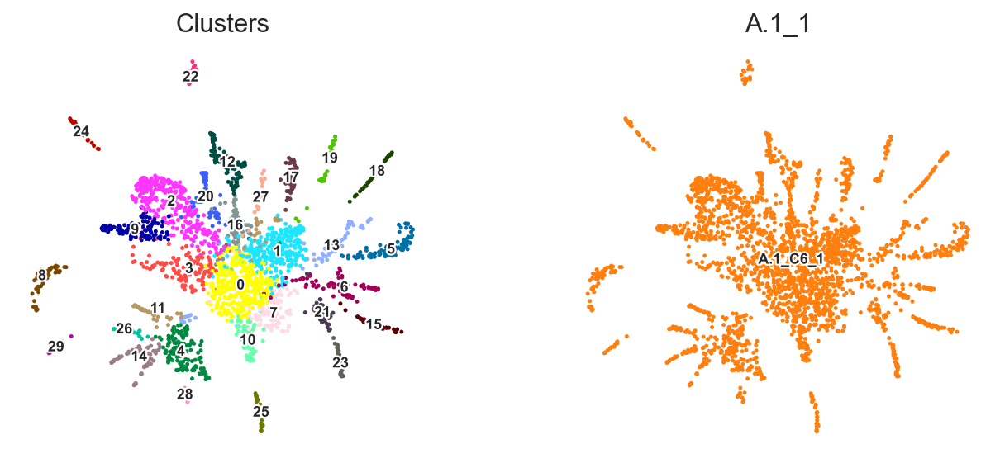

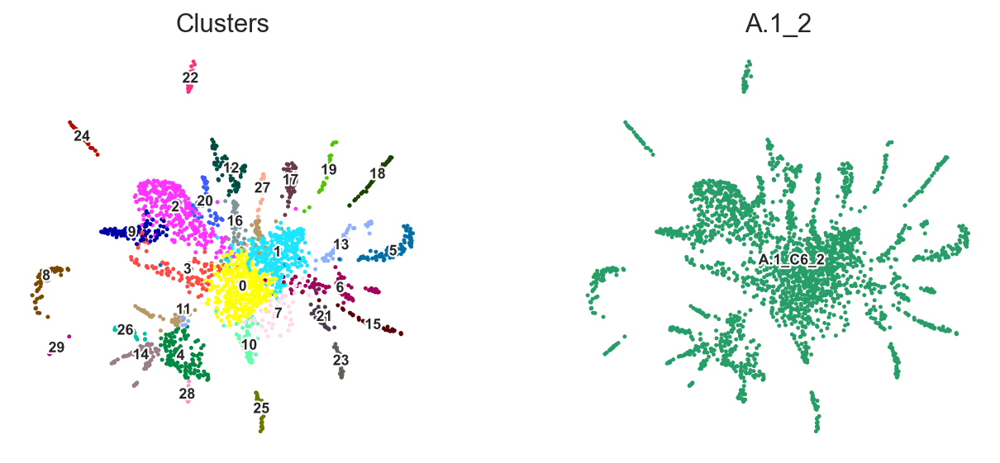

In [77]:
#Plot samples individually
sc.pl.umap(pdam[pdam.obs.loc[pdam.obs['sample'].isin(['4.1_C3'])].index.tolist(), ], color= ['leiden','sample'], title=['Clusters', '4.1'], legend_loc= 'on data',  legend_fontsize=8, legend_fontoutline=2,  frameon=False, size=20,ncols=2)
sc.pl.umap(pdam[pdam.obs.loc[pdam.obs['sample'].isin(['A.1_C6_1'])].index.tolist(), ], color= ['leiden','sample'], title=['Clusters', 'A.1_1'], legend_loc= 'on data',  legend_fontsize=8, legend_fontoutline=2,  frameon=False, size=20,ncols=2)
sc.pl.umap(pdam[pdam.obs.loc[pdam.obs['sample'].isin(['A.1_C6_2'])].index.tolist(), ], color= ['leiden','sample'], title=['Clusters', 'A.1_2'], legend_loc= 'on data',  legend_fontsize=8, legend_fontoutline=2,  frameon=False, size=20,ncols=2)

In [78]:
#Rank and extract marker genes for all clusters
sc.tl.rank_genes_groups(pdam, 'leiden', n_genes=1000,method='wilcoxon')

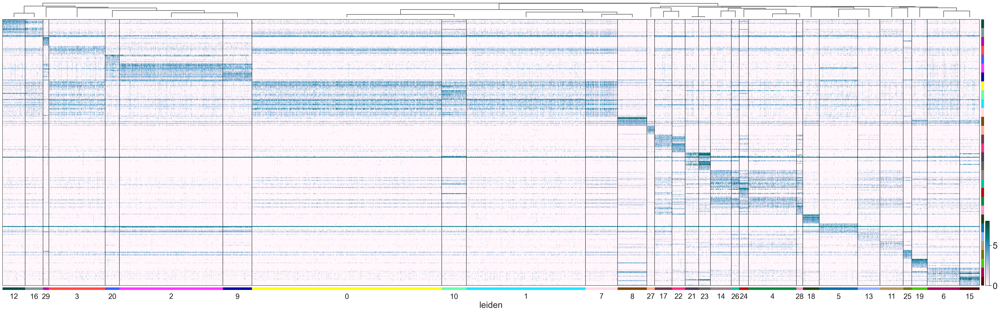

In [79]:
#Heatmap of top 10 marker genes per cluster
sc.tl.dendrogram(pdam, 'leiden', n_pcs=23)
sc.settings.set_figure_params(dpi=80, facecolor='white',fontsize=25)
sc.pl.rank_genes_groups_heatmap(pdam, n_genes=10, swap_axes=True, cmap='PuBuGn', vmin=0, vmax=8, show=True, figsize=(50,15))

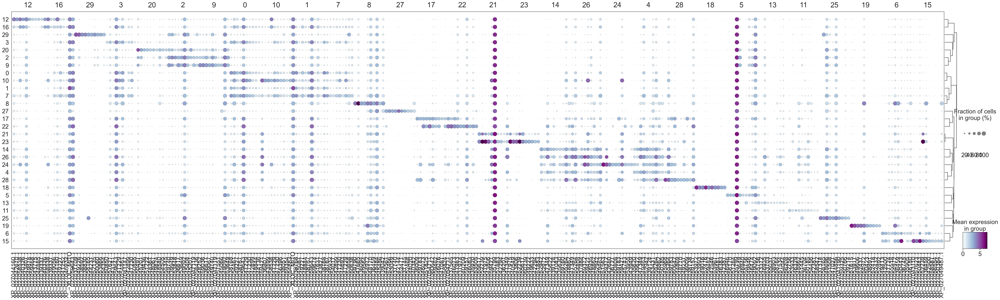

In [80]:
#Dotplot of top 10 marker genes per cluster
sc.pl.rank_genes_groups_dotplot(pdam, n_genes=10, groupby='leiden', cmap='BuPu', show=True, figsize=(60,15))

In [81]:
#Make a dataframe with cluster marker genes
clusters = np.unique(pdam.obs['leiden'])
clusters = clusters.astype('int') 
clusters = np.sort(clusters) 
clusters = clusters.astype('str') 
markers_pdam = pd.DataFrame()
clus = []
markerGene = []
padj = []
logfoldchange = []
for i in clusters:
  genes = pdam.uns['rank_genes_groups']['names'][str(i)]
  clus += list(np.repeat(i,len(genes)))
  markerGene += list(genes)
  padj += list(pdam.uns['rank_genes_groups']['pvals_adj'][str(i)])
  logfoldchange += list(pdam.uns ['rank_genes_groups']['logfoldchanges'][str(i)])
markers_pdam['clus'] = clus
markers_pdam['markerGene'] = markerGene
markers_pdam['padj'] = padj
markers_pdam['logfoldchange'] = logfoldchange

In [82]:
#Select only significant markers
significant = []
print(markers_pdam)
for index,row in markers_pdam.iterrows():
    if row['padj'] < 0.05:
        significant += "T"
    else:
        significant += "F"
markers_pdam['significant'] = significant
significant_markers_pdam = markers_pdam[markers_pdam.significant == "T"]

      clus      markerGene           padj  logfoldchange
0        0  XP_027038768.1  5.549506e-293       3.688624
1        0  XP_027054461.1  7.780102e-250       2.493371
2        0  XP_027049227.1  1.349633e-226       2.839691
3        0  XP_027038767.1  1.880701e-175       3.210399
4        0  XP_027059643.1  3.218798e-150       1.381599
...    ...             ...            ...            ...
29995   29  XP_027037243.1   9.999623e-01       3.412939
29996   29  XP_027043751.1   9.999623e-01       0.955551
29997   29  XP_027036668.1   9.999623e-01       1.037936
29998   29  XP_027056882.1   9.999623e-01       1.795823
29999   29  XP_027042256.1   9.999623e-01       0.608575

[30000 rows x 4 columns]


In [93]:
#significant_markers_pdam.to_csv('/Users/Julia/Desktop/supplementary_paper_Sept24/sc_atlases/pocillopora/pocillopora_significant_markers_FC.csv', sep =',')

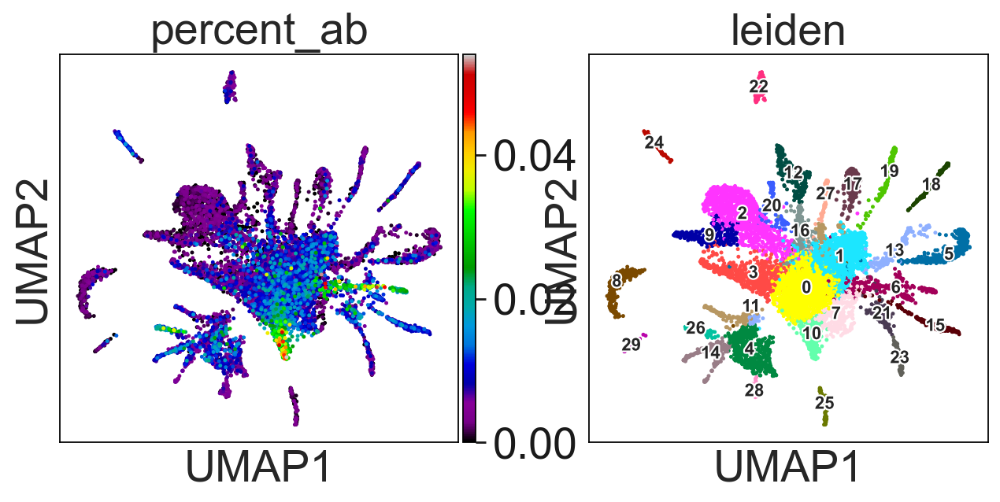

In [83]:
#Plot percentage of aboral genes per cluster in the umap
#run once
all_aboral = set()
with open('/Users/Julia/Documents/lbdv/python_scripts/aboral_clusters/IDs_pocillopora_aboral_ncbi.txt') as fh:
    for line in fh:
        line = line.rstrip()
        parts = line.split()
        all_aboral.add(parts[0])
aboral_genes = pdam.var_names.isin(all_aboral)
pdam.obs['percent_ab'] = np.sum(
   pdam[:,aboral_genes].X, axis=1).A1 / np.sum(pdam.X, axis=1).A1
sc.pl.umap(pdam,color=['percent_ab','leiden'],size=20,color_map='nipy_spectral', legend_loc= 'on data' , legend_fontoutline=2, legend_fontsize=10)